## Analisando dados de vendas de vídeo games

In [4]:
import pandas as pd
import plotly.express as px

In [5]:
dados = pd.read_csv('vgchartz-2024.csv')
jogos = pd.DataFrame(dados)
jogos

,img,title,console,genre,publisher,developer,critic_score,total_sales,na_sales,jp_sales,pal_sales,other_sales,release_date,last_update
0,/games/boxart/full_6510540AmericaFrontccc.jpg,Grand Theft Auto V,PS3,Action,Rockstar Games,Rockstar North,9.4,20.32,6.37,0.99,9.85,3.12,2013-09-17,NaN
1,/games/boxart/full_5563178AmericaFrontccc.jpg,Grand Theft Auto V,PS4,Action,Rockstar Games,Rockstar North,9.7,19.39,6.06,0.60,9.71,3.02,2014-11-18,2018-01-03
2,/games/boxart/827563ccc.jpg,Grand Theft Auto: Vice City,PS2,Action,Rockstar Games,Rockstar North,9.6,16.15,8.41,0.47,5.49,1.78,2002-10-28,NaN
3,/games/boxart/full_9218923AmericaFrontccc.jpg,Grand Theft Auto V,X360,Action,Rockstar Games,Rockstar North,NaN,15.86,9.06,0.06,5.33,1.42,2013-09-17,NaN
4,/games/boxart/full_4990510AmericaFrontccc.jpg,Call of Duty: Black Ops 3,PS4,Shooter,Activision,Treyarch,8.1,15.09,6.18,0.41,6.05,2.44,2015-11-06,2018-01-14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64011,/games/boxart/full_2779838AmericaFrontccc.jpg,XBlaze Lost: Memories,PC,Visual Novel,Aksys Games,Arc System Works,NaN,NaN,NaN,NaN,NaN,NaN,2016-08-11,2019-01-28
64012,/games/boxart/full_8031506AmericaFrontccc.jpg,"Yoru, Tomosu",PS4,Visual Novel,Nippon Ichi Software,Nippon Ichi Software,NaN,NaN,NaN,NaN,NaN,NaN,2020-07-30,2020-05-09
64013,/games/boxart/full_6553045AmericaFrontccc.jpg,"Yoru, Tomosu",NS,Visual Novel,Nippon Ichi Software,Nippon Ichi Software,NaN,NaN,NaN,NaN,NaN,NaN,2020-07-30,2020-05-09
64014,/games/boxart/full_6012940JapanFrontccc.png,Yunohana SpRING! ~Mellow Times~,NS,Visual Novel,Idea Factory,Otomate,NaN,NaN,NaN,NaN,NaN,NaN,2019-02-28,2019-02-24


In [6]:
jogos.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64016 entries, 0 to 64015
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   img           64016 non-null  object 
 1   title         64016 non-null  object 
 2   console       64016 non-null  object 
 3   genre         64016 non-null  object 
 4   publisher     64016 non-null  object 
 5   developer     63999 non-null  object 
 6   critic_score  6678 non-null   float64
 7   total_sales   18922 non-null  float64
 8   na_sales      12637 non-null  float64
 9   jp_sales      6726 non-null   float64
 10  pal_sales     12824 non-null  float64
 11  other_sales   15128 non-null  float64
 12  release_date  56965 non-null  object 
 13  last_update   17879 non-null  object 
dtypes: float64(6), object(8)
memory usage: 6.8+ MB


In [7]:
jogos = jogos.drop("img", axis = 1)

In [8]:
print(jogos.head(10))

                            title console             genre       publisher  \
0              Grand Theft Auto V     PS3            Action  Rockstar Games   
1              Grand Theft Auto V     PS4            Action  Rockstar Games   
2     Grand Theft Auto: Vice City     PS2            Action  Rockstar Games   
3              Grand Theft Auto V    X360            Action  Rockstar Games   
4       Call of Duty: Black Ops 3     PS4           Shooter      Activision   
5  Call of Duty: Modern Warfare 3    X360           Shooter      Activision   
6         Call of Duty: Black Ops    X360           Shooter      Activision   
7           Red Dead Redemption 2     PS4  Action-Adventure  Rockstar Games   
8      Call of Duty: Black Ops II    X360           Shooter      Activision   
9      Call of Duty: Black Ops II     PS3           Shooter      Activision   

        developer  critic_score  total_sales  na_sales  jp_sales  pal_sales  \
0  Rockstar North           9.4        20.32      6

In [9]:
jogos.describe()

,critic_score,total_sales,na_sales,jp_sales,pal_sales,other_sales
count,6678.000000,18922.000000,12637.000000,6726.000000,12824.000000,15128.000000
mean,7.220440,0.349113,0.264740,0.102281,0.149472,0.043041
std,1.457066,0.807462,0.494787,0.168811,0.392653,0.126643
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,6.400000,0.030000,0.050000,0.020000,0.010000,0.000000
50%,7.500000,0.120000,0.120000,0.040000,0.040000,0.010000
75%,8.300000,0.340000,0.280000,0.120000,0.140000,0.030000
max,10.000000,20.320000,9.760000,2.130000,9.850000,3.120000


In [10]:
for col in ('title','console','genre','publisher','developer'):
    print(jogos[col].value_counts())
    print('='*50)

title
Plants vs. Zombies                  17
Pac-Man                             16
Monopoly                            15
Doom                                14
Double Dragon                       14
                                    ..
Bakegyamon: Ayakashi Fighting        1
Avatar Showdown                      1
Avatar Fighter Online                1
Avatar Fighter                       1
Yurukill: The Calumniation Games     1
Name: count, Length: 39798, dtype: int64
console
PC      12617
PS2      3565
DS       3288
PS4      2878
PS       2707
        ...  
TG16        3
FDS         1
C128        1
Aco         1
BBCM        1
Name: count, Length: 81, dtype: int64
genre
Misc                9304
Action              8557
Adventure           6260
Role-Playing        5721
Sports              5586
Shooter             5410
Platform            4001
Strategy            3685
Puzzle              3521
Racing              3425
Simulation          3158
Fighting            2367
Action-Adventure  

*Quais são os 10 jogos mais vendidos? E como é a venda desses para cada plataforma?*

In [11]:
jogos_mais_vendidos = jogos.groupby(['title'])['total_sales'].sum().sort_values(ascending=False) # agrupa por título, soma as vendas de todas as ocorrências daquele jogo e organiza elas da maior para a menor
# transformar a série em data frame
top10 = pd.DataFrame({'titulo':jogos_mais_vendidos.index, 'vendas':jogos_mais_vendidos.values})
top10 = top10.head(10)
top10

,titulo,vendas
0,Grand Theft Auto V,64.29
1,Call of Duty: Black Ops,30.99
2,Call of Duty: Modern Warfare 3,30.71
3,Call of Duty: Black Ops II,29.59
4,Call of Duty: Ghosts,28.80
5,Call of Duty: Black Ops 3,26.72
6,Call of Duty: Modern Warfare 2,25.02
7,Minecraft,24.01
8,Grand Theft Auto IV,22.53
9,Call of Duty: Advanced Warfare,21.78


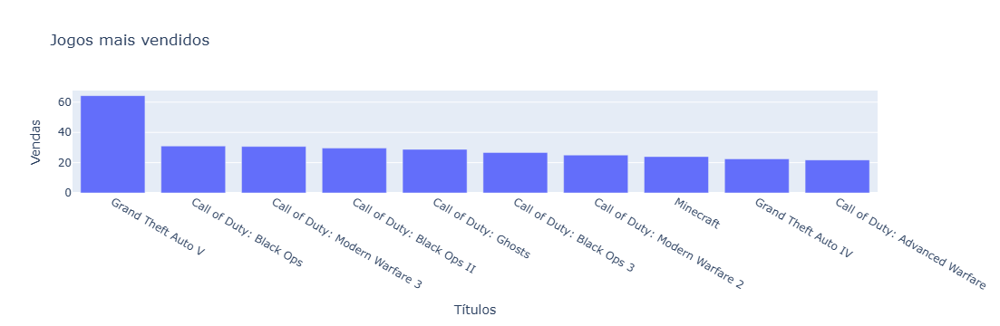

In [23]:
px.bar(top10, x='titulo', y='vendas', title='Jogos mais vendidos', labels={
  'titulo':'Títulos','vendas':'Vendas'  
}
      )

In [13]:
df_top10 = jogos[jogos['title'].isin(top10['titulo'].unique())]
df_top10 = df_top10.sort_values(by='title')
px.bar(df_top10, x='title', y='total_sales', color='console',title='Jogos mais vendidos') # adiciona o recorte por consoles

*Como foi a venda de jogos por ano para as distribuidoras que mais venderam?*

In [15]:
jogos['year'] = pd.to_datetime(jogos['release_date']).dt.year
pub_vendas_por_ano = jogos.groupby(['publisher', 'year']).agg({'total_sales': 'sum'}).reset_index()

pub_vendas = pub_vendas_por_ano.groupby('publisher').sum('total_sales').reset_index()

top_pub = pub_vendas_por_ano[pub_vendas_por_ano['publisher'].isin(pub_vendas[pub_vendas['total_sales'] > 100]['publisher'].values)]

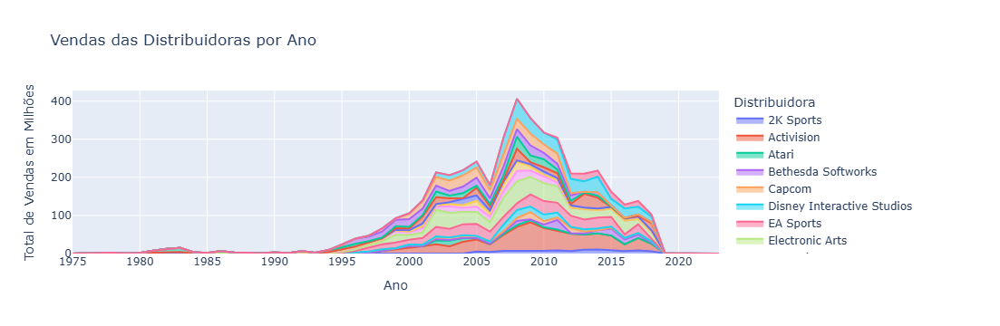

In [25]:
px.area(top_pub, x='year', y='total_sales',
        color='publisher', title='Vendas das Distribuidoras por Ano',
        labels={
        'total_sales': 'Total de Vendas em Milhões',
        'year': 'Ano',
        'publisher':'Distribuidora'
    })

*A nota de um jogo influencia as suas vendas?*

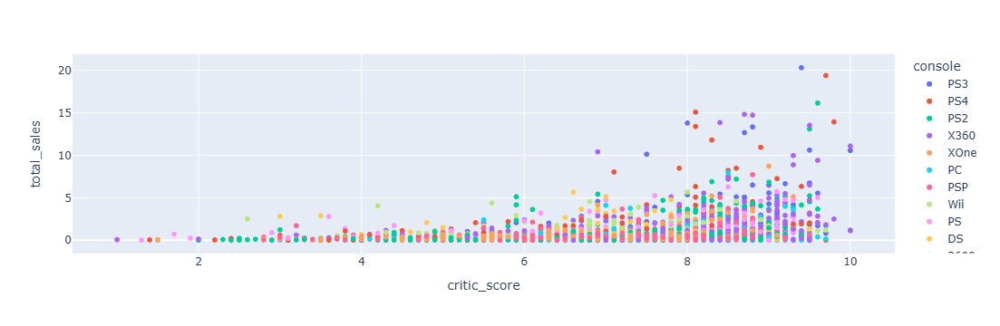

In [29]:
px.scatter(jogos, x='critic_score',y='total_sales',color='console',hover_data=['title']) ##hover mostra uma informação textual quando passa o mouse no ponto

*Como variam as notas de acordo com o gênero?*

In [33]:
generos_populares = jogos[jogos['genre'].isin(['Action','Adventure','Role-Playing','Shooter','Platform'])]

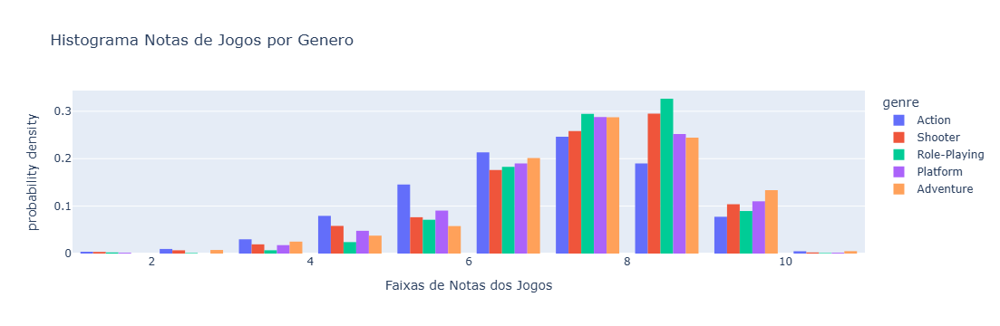

In [34]:
px.histogram(
    generos_populares, x='critic_score', 
    color='genre', title='Histograma Notas de Jogos por Genero',
    nbins=10, barmode='group', histnorm='probability density',
    labels={
        'count': 'Quantidades de Notas por Faixa',
        'critic_score': 'Faixas de Notas dos Jogos'
    }
)

*Como varia o número de vendas dos jogos em cada região?*

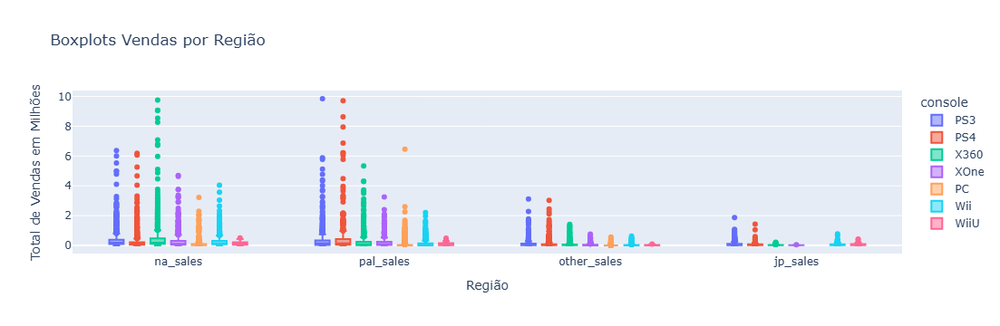

In [35]:
plataformas = jogos[jogos['console'].isin(['PS3', 'PS4', 'X360', 'XOne', 'Wii', 'WiiU', 'PC'])]
px.box(
    plataformas, y=['na_sales', 'pal_sales', 'other_sales', 'jp_sales'], #lista das regioes
    hover_data=['title'], color='console', title='Boxplots Vendas por Região',
    labels={
        'value': 'Total de Vendas em Milhões',
        'variable': 'Região'
    }
)